## Autoencoder for Song Orders:

In [1]:
from Autoencoder_alla_Valerio import Autoencoder
from Variational_Autoencoder_alla_Valerio import VAE
from LSTM_Autoencoder import LSTM_Autoencoder
from Dense_Autoencoder import Dense_Autoencoder
import numpy as np
import matplotlib.pyplot as plt
from Snippets import Snippets
from IPython.display import display, Audio
import librosa
from tensorflow.keras.layers import Masking
import tensorflow as tf
import os
from sklearn.model_selection import train_test_split
import math

### Input Data:
We load the array with all song_orders. We need to bring them all to the same size, so we can use them as training data.

In [2]:
subfolder = "4.0_256"
model_name = "VAE_Vocals_128D_17388samples_20Epochs"
path = os.path.join("data_and_models", subfolder, model_name + "_song_order500.npy")
song_orders = np.load(path, allow_pickle=True)

In [3]:
flattened_orders = np.asarray([item for order in song_orders for item in order])
old_min = flattened_orders.min()
old_max = flattened_orders.max()

In [4]:
norm_orders = Snippets._normalise(song_orders, 0.01, 1, old_min, old_max)

In [5]:
# old_min = x_train.min()
# old_max = x_train.max()

# def normalise(array, new_min, new_max, old_min, old_max):
#         norm_array = (array - old_min) / (old_max - old_min)
#         norm_array = norm_array * (new_max - new_min) + new_min
#         return norm_array

# x_train = normalise(x_train, 0.01, 1, old_min, old_max)

For the training of the autoencoder, we need all song-orders to be of the same length. Additionally the length has to be an even number. We bring each song to the length of the longest song by adding the value -1. 

In [6]:
max_song_length = 0

for i in range(0, len(song_orders)):
    if len(song_orders[i]) > max_song_length:
        max_song_length = len(song_orders[i])
        #if not (max_song_length % 2) == 0: #increase max_song_length to even number. This is crutial for the Shape of Autoencoder input data.
         #   max_song_length += 1       
max_song_length = 2**math.ceil(math.log2(max_song_length))
print("The longest song had: " + str(max_song_length) +" snippets")



x_train = []
for order in norm_orders:
    if order.shape[0] < max_song_length:
        padded_order = np.pad(order,((0,max_song_length-order.shape[0]),(0,0)), constant_values=(0,0))
        x_train.append(padded_order)
x_train = np.asarray(x_train)
x_train = x_train.reshape(x_train.shape[0],x_train.shape[1],x_train.shape[2])

print("Our trainingsdata has the shape: " + str(x_train.shape))

The longest song had: 256 snippets
Our trainingsdata has the shape: (361, 256, 128)


We can normalise the data and denormalise it later

In [7]:
#x_train = Snippets._normalise(x_train, 0,1, old_min, old_max)

In [8]:
# Add a channel for Mask 
#for order in norm_orders:
#     sample = []
#     for coordinates in order:
#         mask = np.sign(coordinates[0])
#         coordinates = np.append(coordinates, mask)
#         sample.append(coordinates)
#     sample = np.asarray(sample)
#     x_train.append(sample)
#x_train = np.asarray(x_train)


In [9]:
# x_train = norm_orders
# x_train[0].shape

In [10]:
# x_train = []
# # for order in norm_orders:
# #     order = order.reshape(order.shape[0], order.shape[1], 1)
# #     x_train.append(order)
# # x_train = np.asarray(x_train)
# x_train.shape

### Build the model
We can build a new model

In [11]:
from tensorflow.keras.layers import Dense, Masking, Input
from tensorflow.keras.models import Model


# autoencoder = LSTM_Autoencoder(
#     input_shape = (x_train[0].shape[1], x_train[0].shape[2]), 
#     lstm_dims = (), 
#     latent_space_dim = 32
# )

# autoencoder = VAE(
#     input_shape=(x_train.shape[1], x_train.shape[2], x_train.shape[3]),
#     conv_filters=(512, 256, 128, 64, 32),
#     conv_kernels=(3, 3, 3, 3, 3),
#     conv_strides=(2, 2, 2, 2, 2),
#     latent_space_dim=32,
# )

input_layer = Input(shape=(256*128,))
masking = Masking()(input_layer)
encoded = Dense(128, activation='relu')(masking)
encoded = Dense(64, activation='relu')(encoded)
encoded = Dense(32, activation='relu')(encoded)

decoder_input = Input(shape=32, name="Decoder_Input")
decoded = Dense(64, activation='relu')(decoder_input)
decoded = Dense(128, activation='relu')(decoded)
decoded = Dense(256*128, activation='sigmoid')(decoded)


encoder = Model(input_layer, encoded)
decoder = Model(decoder_input, decoded)

model_input = input_layer
model_output = decoder(encoder(model_input))
autoencoder = Model(model_input, model_output, name="Autoencoder")

autoencoder.summary()

Model: "Autoencoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 32768)]           0         
_________________________________________________________________
model (Functional)           (None, 32)                4204768   
_________________________________________________________________
model_1 (Functional)         (None, 32768)             4237504   
Total params: 8,442,272
Trainable params: 8,442,272
Non-trainable params: 0
_________________________________________________________________


In [12]:
x_train_flat = x_train.reshape(x_train.shape[0],x_train.shape[1]*x_train.shape[2])
x_train_flat, x_test_flat,_,_ = train_test_split(x_train_flat, x_train_flat, test_size=0.1)

# x_train, x_test, _, _ = train_test_split(x_train, x_train, test_size=0.05)

In [13]:
LEARNING_RATE =  0.0001
EPOCHS = 20
BATCH_SIZE = 4




autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
autoencoder.fit(x_train_flat, x_train_flat,
                epochs=100,
                batch_size=32,
                shuffle=True,
                validation_data=(x_test_flat, x_test_flat))
# autoencoder.compile_model(LEARNING_RATE)
# autoencoder.train(x_train=x_train, x_test=x_test, batch_size=BATCH_SIZE, num_epochs=EPOCHS)
# for i in range(EPOCHS):
#     np.random.shuffle(x_train);
#     for j, sample in enumerate(x_train):
#         autoencoder.model.train_on_batch(sample,sample)
#         print("Epoch: " + str(i+1) + " Sample " + str(j+1), end="\r")

# path = os.path.join("models_and_data", subfolder, model_name + "ML2_Autoencoder")
# autoencoder.save(path)

Train on 324 samples, validate on 37 samples
Epoch 1/100


2022-04-18 12:56:44.350806: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


324/324 [==============================] - 1s 4ms/sample - loss: 0.5017 - val_loss: 0.2915
Epoch 2/100
 32/324 [=>............................] - ETA: 0s - loss: 0.2393

/Users/dearvr-Tester/Documents/MetaHuman/venv/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:2426: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


324/324 [==============================] - 1s 2ms/sample - loss: 0.2269 - val_loss: 0.2103
Epoch 3/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1986 - val_loss: 0.2030
Epoch 4/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1891 - val_loss: 0.1945
Epoch 5/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1794 - val_loss: 0.1871
Epoch 6/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1743 - val_loss: 0.1841
Epoch 7/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1716 - val_loss: 0.1832
Epoch 8/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1711 - val_loss: 0.1831
Epoch 9/100
324/324 [==============================] - 1s 3ms/sample - loss: 0.1699 - val_loss: 0.1819
Epoch 10/100
324/324 [==============================] - 1s 2ms/sample - loss: 0.1687 - val_loss: 0.1811
Epoch 11/100
324/324 [==============================] - 1s 3ms/sample - loss: 0.1678

# Check Results
Check how good the autoencoder is in reconstructing a song order.

In [35]:
x_train[song_num].flatten().shape

(32768,)

In [68]:
song_num = 0
test_sample = x_train[song_num].flatten()
test_sample = test_sample.reshape(1, test_sample.shape[0])

latent_representation = encoder.predict(test_sample)
reconstructed_data = decoder.predict(latent_representation)
reconstructed_data = reconstructed_data.reshape(int(reconstructed_data.shape[1]/128),128)
reconstructed_data = Snippets._denormalise(reconstructed_data, 0.01, 1, old_min, old_max)
pad_prediction = np.argwhere(reconstructed_data< (old_min + (abs(old_min - old_max) * 0.1)))[:,0].min() # predict which coordinates were probably just filled up
reconstructed_data = reconstructed_data[:pad_prediction]
print(reconstructed_data.shape)

original = song_orders[song_num]
print(original.shape)
#original = Snippets._denormalise(original, 0.01, 1, old_min, old_max)

# song_num = 0
# latent_representation = autoencoder.encoder.predict(x_train[song_num].reshape(1, x_train[0].shape[0],x_train[0].shape[1],x_train[0].shape[2]))
# reconstructed_data = autoencoder.decoder.predict(latent_representation)
# reconstructed_data = Snippets._denormalise(reconstructed_data, 0, 1, old_min, old_max)

# original = x_train[song_num]
# original = Snippets._denormalise(original, 0.01, 1, old_min, old_max)

(34, 128)
(34, 128)


This is the original


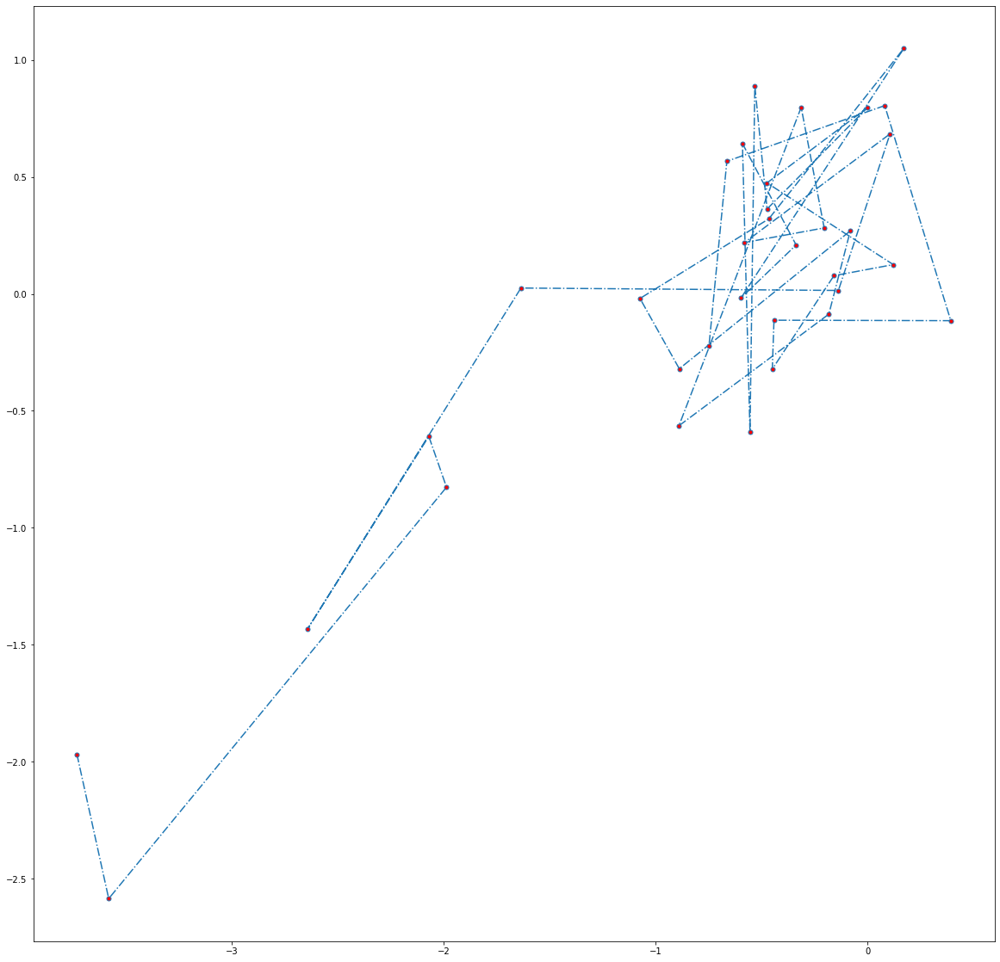

In [69]:
print("This is the original")
plt.figure(figsize=(20,20))
plt.plot(original[:, 0], original[:, 1], '-.o', markersize=5, markerfacecolor='red')
plt.show()

This is the reconstruction


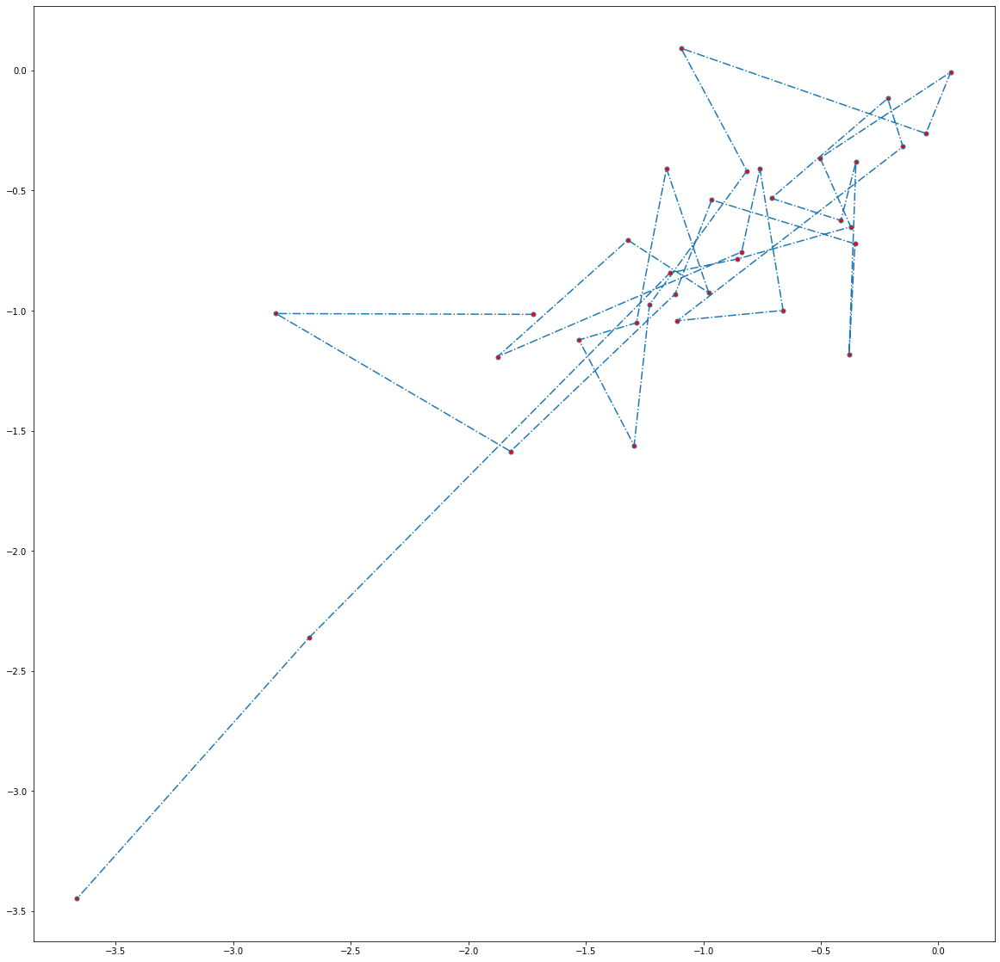

In [70]:

print("This is the reconstruction")
plt.figure(figsize=(20,20))
plt.plot(reconstructed_data[:, 0], reconstructed_data[:, 1], '-.o', markersize=5, markerfacecolor='red')
plt.show()

In [71]:
WIN_LENGTH = 690*2
HOP_LENGTH = 690
N_FFT = 690*2


path = os.path.join("data_and_models", subfolder, "VAE_Vocals_128D_17388samples_20Epochs")
snippet_autoencoder = VAE.load(path)

reconstructed_data = reconstructed_data.reshape(reconstructed_data.shape[0], reconstructed_data.shape[1])
print(reconstructed_data.shape)
      
reconstructed_signal, reconstructed_spectos = Snippets.latent_representation_to_pcm(latent_representations=reconstructed_data,
                                                                                    model=snippet_autoencoder, 
                                                                                    hop_length=HOP_LENGTH, 
                                                                                    n_fft=N_FFT, 
                                                                                    win_length=WIN_LENGTH)

Instructions for updating:
Colocations handled automatically by placer.
(34, 128)


/Users/dearvr-Tester/Documents/MetaHuman/venv/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:2426: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


In [72]:
display(Audio(reconstructed_signal, rate=44100))

In [74]:
folder_path = os.path.join('demo_data', 'stems2')
paths = librosa.util.find_files(folder_path, ext=['wav'])
original_song, _ = librosa.load(paths[song_num],sr=44100, mono=True)

print("This is the original song: \n")
display(Audio(original_song, rate=44100))


This is the original song: 



https://machinelearningmastery.com/lstm-autoencoders/